In [10]:
#Download and extract Food 101 Dataset

In [1]:
#!pip install --upgrade tensorflow


In [8]:
import tensorflow as tf


In [9]:
#!pip install matplotlib
#!pip install opencv-python


In [10]:
import matplotlib.image as img
%matplotlib inline
import numpy as np
from collections import defaultdict
import collections
from shutil import copy
from shutil import copytree, rmtree
import tensorflow.keras.backend as K
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras import regularizers
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D, GlobalAveragePooling2D, AveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.regularizers import l2
from tensorflow import keras
from tensorflow.keras import models
import cv2

In [5]:
# Check if GPU is enabled
print(tf.__version__)
print(tf.test.gpu_device_name())

2.17.0



In [12]:
%cd C:\Users\Zaïneb\Desktop\food_cal

C:\Users\Zaïneb\Desktop\food_cal


#Understand dataset structure and files

In [13]:
import subprocess

# Vérifier le dossier extrait du dataset
result = subprocess.run(['dir', 'C:\\Users\\Zaïneb\\Desktop\\food_cal'], shell=True, capture_output=True, text=True)
print(result.stdout)

 Le volume dans le lecteur C n'a pas de nom.
 Le num‚ro de s‚rie du volume est FADC-E1BA

 R‚pertoire de C:\Users\Za‹neb\Desktop\food_cal

23/07/2024  19:36    <DIR>          .
23/07/2024  19:36    <DIR>          ..
23/07/2024  20:00    <DIR>          model
23/07/2024  19:38    <DIR>          server
23/07/2024  19:36    <DIR>          UI
               0 fichier(s)                0 octets
               5 R‚p(s)  26ÿ563ÿ387ÿ392 octets libres



In [14]:
os.listdir('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\images')

['.DS_Store',
 'apple_pie',
 'baby_back_ribs',
 'baklava',
 'beef_carpaccio',
 'beef_tartare',
 'beet_salad',
 'beignets',
 'bread_pudding',
 'breakfast_burrito',
 'bruschetta',
 'caesar_salad',
 'cannoli',
 'caprese_salad',
 'carrot_cake',
 'ceviche',
 'cheesecake',
 'cheese_plate',
 'chicken_curry',
 'chicken_quesadilla',
 'chicken_wings',
 'chocolate_cake',
 'chocolate_mousse',
 'churros',
 'clam_chowder',
 'club_sandwich',
 'crab_cakes',
 'creme_brulee',
 'croque_madame',
 'cup_cakes',
 'deviled_eggs',
 'donuts',
 'dumplings',
 'edamame',
 'eggs_benedict',
 'escargots',
 'falafel',
 'filet_mignon',
 'fish_and_chips',
 'foie_gras',
 'french_fries',
 'french_onion_soup',
 'french_toast',
 'fried_calamari',
 'fried_rice',
 'frozen_yogurt',
 'garlic_bread',
 'gnocchi',
 'greek_salad',
 'grilled_cheese_sandwich',
 'grilled_salmon',
 'guacamole',
 'gyoza',
 'hamburger',
 'hot_and_sour_soup',
 'hot_dog',
 'huevos_rancheros',
 'hummus',
 'ice_cream',
 'lasagna',
 'lobster_bisque',
 'lobste

In [17]:
os.listdir('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\meta')

['classes.txt',
 'labels.txt',
 'test.json',
 'test.txt',
 'train.json',
 'train.txt']

In [18]:
file_path = 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\meta\\train.txt'

with open(file_path, 'r') as file:
    # Lire les 10 premières lignes
    for _ in range(10):
        line = file.readline()
        if not line:
            break
        print(line.strip())


apple_pie/1005649
apple_pie/1014775
apple_pie/1026328
apple_pie/1028787
apple_pie/1043283
apple_pie/1050519
apple_pie/1057749
apple_pie/1057810
apple_pie/1072416
apple_pie/1074856


In [19]:
file_path = 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\meta\\classes.txt'

with open(file_path, 'r') as file:
    # Lire les 10 premières lignes
    for _ in range(10):
        line = file.readline()
        if not line:
            break
        print(line.strip())

apple_pie
baby_back_ribs
baklava
beef_carpaccio
beef_tartare
beet_salad
beignets
bread_pudding
breakfast_burrito
bruschetta


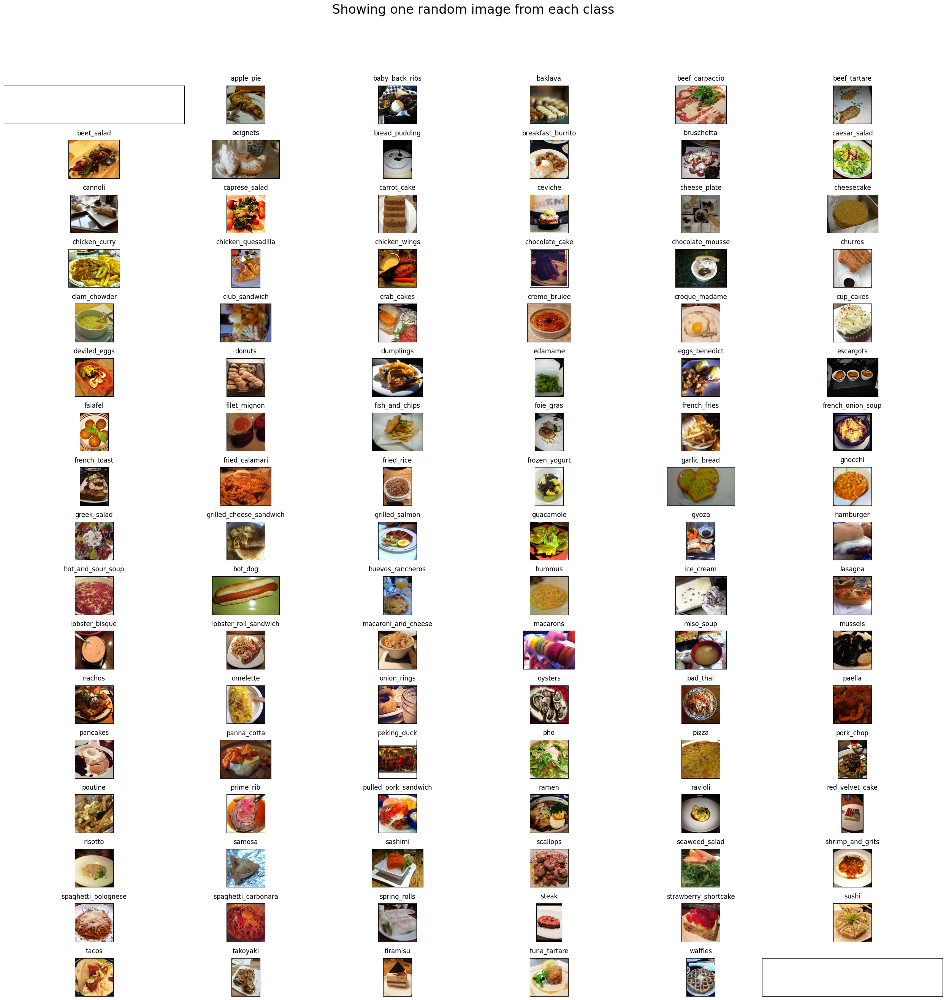

In [20]:
# Visualize the data, showing one image per class from 100 classes
rows = 17
cols = 6
fig, ax = plt.subplots(rows, cols, figsize=(25,25))
fig.suptitle("Showing one random image from each class", y=1.05, fontsize=24) # Adding  y=1.05, fontsize=24 helped me fix the suptitle overlapping with axes issue
data_dir = "C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\images"
foods_sorted = sorted(os.listdir(data_dir))
food_id = 0
for i in range(rows):
 for j in range(cols):
    try:
      food_selected = foods_sorted[food_id] 
      food_id += 1
    except:
      break
    if food_selected == '.DS_Store':
        continue
    food_selected_images = os.listdir(os.path.join(data_dir,food_selected)) # returns the list of all files present in each food category
    food_selected_random = np.random.choice(food_selected_images) # picks one food item from the list as choice, takes a list and returns one random item
    img = plt.imread(os.path.join(data_dir,food_selected, food_selected_random))
    ax[i][j].imshow(img)
    ax[i][j].set_title(food_selected, pad = 10)
    
plt.setp(ax, xticks=[],yticks=[])
plt.tight_layout()
# https://matplotlib.org/users/tight_layout_guide.html

In [21]:
#Split the image data into train and test using train.txt and test.txt

In [22]:
# Helper method to split dataset into train and test folders
def prepare_data(filepath, src,dest):
  classes_images = defaultdict(list)
  with open(filepath, 'r') as txt:
      paths = [read.strip() for read in txt.readlines()]
      for p in paths:
        food = p.split('/')
        classes_images[food[0]].append(food[1] + '.jpg')

  for food in classes_images.keys():
    print("\nCopying images into ",food)
    if not os.path.exists(os.path.join(dest,food)):
      os.makedirs(os.path.join(dest,food))
    for i in classes_images[food]:
      copy(os.path.join(src,food,i), os.path.join(dest,food,i))
  print("Copying Done!")

In [26]:
# Prepare train dataset by copying images from food_cal/images to food_cal/train using the file train.txt
#dans chaque classe on prend 750 pour train et 250 pour test(80% ,20%)
%cd /
print("Creating train data...")
prepare_data('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\meta\\train.txt', 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\images', 'train')

C:\
Creating train data...

Copying images into  apple_pie

Copying images into  baby_back_ribs

Copying images into  baklava

Copying images into  beef_carpaccio

Copying images into  beef_tartare

Copying images into  beet_salad

Copying images into  beignets

Copying images into  bread_pudding

Copying images into  breakfast_burrito

Copying images into  bruschetta

Copying images into  caesar_salad

Copying images into  cannoli

Copying images into  caprese_salad

Copying images into  carrot_cake

Copying images into  ceviche

Copying images into  cheesecake

Copying images into  cheese_plate

Copying images into  chicken_curry

Copying images into  chicken_quesadilla

Copying images into  chicken_wings

Copying images into  chocolate_cake

Copying images into  chocolate_mousse

Copying images into  churros

Copying images into  clam_chowder

Copying images into  club_sandwich

Copying images into  crab_cakes

Copying images into  creme_brulee

Copying images into  croque_madame

C

In [27]:
# Check how many files are in the train folder
import subprocess

# Define the PowerShell command
command = 'powershell.exe Get-ChildItem -Path .\\train -File -Recurse | Measure-Object | %{$_.Count}'

# Run the command
result = subprocess.run(command, capture_output=True, text=True)

# Print the result
print("Total number of samples in train folder")
print(result.stdout.strip())

Total number of samples in train folder
75000


In [18]:
# Prepare test data by copying images from food-101/images to food-101/test using the file test.txt
print("Creating test data...")
prepare_data('C:\\Users\\Zaïneb\\Desktop\\food_cal\\meta\\test.txt', 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\images', 'test')


Creating test data...

Copying images into  apple_pie

Copying images into  baby_back_ribs

Copying images into  baklava

Copying images into  beef_carpaccio

Copying images into  beef_tartare

Copying images into  beet_salad

Copying images into  beignets

Copying images into  bread_pudding

Copying images into  breakfast_burrito

Copying images into  bruschetta

Copying images into  caesar_salad

Copying images into  cannoli

Copying images into  caprese_salad

Copying images into  carrot_cake

Copying images into  ceviche

Copying images into  cheesecake

Copying images into  cheese_plate

Copying images into  chicken_curry

Copying images into  chicken_quesadilla

Copying images into  chicken_wings

Copying images into  chocolate_cake

Copying images into  chocolate_mousse

Copying images into  churros

Copying images into  clam_chowder

Copying images into  club_sandwich

Copying images into  crab_cakes

Copying images into  creme_brulee

Copying images into  croque_madame

Copyin

In [24]:
# Check how many files are in the test folder

import subprocess

# Define the PowerShell command
command = 'powershell.exe Get-ChildItem -Path .\\test -File -Recurse | Measure-Object | %{$_.Count}'

# Run the command
result = subprocess.run(command, capture_output=True, text=True)

# Print the result
print("Total number of samples in test folder")
print(result.stdout.strip())

Total number of samples in test folder
25000


In [19]:
#Create a subset of data with few classes(3) - train_mini and test_mini for experimenting

In [18]:
# List of all 100 types of foods(sorted alphabetically)
del foods_sorted[0] # remove .DS_Store from the list

In [19]:
foods_sorted

['apple_pie',
 'baby_back_ribs',
 'baklava',
 'beef_carpaccio',
 'beef_tartare',
 'beet_salad',
 'beignets',
 'bread_pudding',
 'breakfast_burrito',
 'bruschetta',
 'caesar_salad',
 'cannoli',
 'caprese_salad',
 'carrot_cake',
 'ceviche',
 'cheese_plate',
 'cheesecake',
 'chicken_curry',
 'chicken_quesadilla',
 'chicken_wings',
 'chocolate_cake',
 'chocolate_mousse',
 'churros',
 'clam_chowder',
 'club_sandwich',
 'crab_cakes',
 'creme_brulee',
 'croque_madame',
 'cup_cakes',
 'deviled_eggs',
 'donuts',
 'dumplings',
 'edamame',
 'eggs_benedict',
 'escargots',
 'falafel',
 'filet_mignon',
 'fish_and_chips',
 'foie_gras',
 'french_fries',
 'french_onion_soup',
 'french_toast',
 'fried_calamari',
 'fried_rice',
 'frozen_yogurt',
 'garlic_bread',
 'gnocchi',
 'greek_salad',
 'grilled_cheese_sandwich',
 'grilled_salmon',
 'guacamole',
 'gyoza',
 'hamburger',
 'hot_and_sour_soup',
 'hot_dog',
 'huevos_rancheros',
 'hummus',
 'ice_cream',
 'lasagna',
 'lobster_bisque',
 'lobster_roll_sandwic

In [29]:
# Helper method to create train_mini and test_mini data samples
def dataset_mini(food_list, src, dest):
  if os.path.exists(dest):
    rmtree(dest) # removing dataset_mini(if it already exists) folders so that we will have only the classes that we want
  os.makedirs(dest)
  for food_item in food_list :
    print("Copying images into",food_item)
    copytree(os.path.join(src,food_item), os.path.join(dest,food_item))

In [212]:
# picking 3 food items and generating separate data folders for the same
food_list = ['apple_pie','pizza','omelette']
src_train = 'train'
dest_train = 'train_mini'
src_test = 'test'
dest_test = 'test_mini'

In [213]:
print("Creating train data folder with new classes")
dataset_mini(food_list, src_train, dest_train)

Creating train data folder with new classes
Copying images into apple_pie
Copying images into pizza
Copying images into omelette


In [214]:
# Check how many files are in the test folder

import subprocess

# Define the PowerShell command
command = 'powershell.exe Get-ChildItem -Path .\\train_mini -File -Recurse | Measure-Object | %{$_.Count}'

# Run the command
result = subprocess.run(command, capture_output=True, text=True)

# Print the result
print("Total number of samples in train_mini folder")
print(result.stdout.strip())

Total number of samples in train_mini folder
2250


In [148]:
print("Creating test data folder with new classes")
dataset_mini(food_list, src_test, dest_test)

Creating test data folder with new classes
Copying images into apple_pie
Copying images into pizza
Copying images into omelette


In [149]:
# Check how many files are in the test folder

import subprocess

# Define the PowerShell command
command = 'powershell.exe Get-ChildItem -Path .\\test_mini -File -Recurse | Measure-Object | %{$_.Count}'

# Run the command
result = subprocess.run(command, capture_output=True, text=True)

# Print the result
print("Total number of samples in test_mini folder")
print(result.stdout.strip())

Total number of samples in test_mini folder
750


In [30]:
import tensorflow as tf
print(tf.__version__)


2.17.0


In [28]:
#Fine tune Inception Pretrained model using Food 100 dataset

In [ ]:

#!pip install scipy




In [37]:
#Visualize the accuracy and loss plots

In [55]:
class PyDataset:
    def __init__(self, *args, **kwargs):
        # Assurez-vous d'appeler le constructeur de la classe parente
        super().__init__(**kwargs)
        # Initialisation de votre classe
        # ...


In [ ]:
#model training with 10 epochs

In [32]:
from tensorflow.keras.layers import Dropout, Dense, GlobalAveragePooling2D
from tensorflow.keras.regularizers import l2
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, Callback, CSVLogger
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow.keras.backend as K
import os

# Classe de rappel personnalisée pour enregistrer le modèle aux epochs spécifiés
class CustomModelCheckpoint(Callback):
    def __init__(self, save_epochs):
        super(CustomModelCheckpoint, self).__init__()
        self.save_epochs = save_epochs

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) in self.save_epochs:
            filepath = f'model_epoch_{epoch + 1:02d}.keras'
            self.model.save(filepath)
            print(f'\nModèle sauvegardé à: {filepath}')

# Paramètres et prétraitement des données
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=1e-6)

K.clear_session()
n_classes = 3
img_width, img_height = 299, 299
train_data_dir = 'train_mini'
validation_data_dir = 'test_mini'
nb_train_samples = 2250
nb_validation_samples = 750
batch_size = 8

train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1. / 255)

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

validation_generator = test_datagen.flow_from_directory(
    validation_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

# Création du modèle
inception = InceptionV3(weights='imagenet', include_top=False)
x = inception.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.2)(x)
predictions = Dense(n_classes, kernel_regularizer=l2(0.005), activation='softmax')(x)

model = Model(inputs=inception.input, outputs=predictions)
model.compile(optimizer=SGD(learning_rate=0.0001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])

# Définition des epochs à sauvegarder
save_epochs = [1, 3, 5, 7, 9]
custom_checkpoint = CustomModelCheckpoint(save_epochs)

# Chemin pour les logs
logs_dir = os.path.join(os.getcwd(), 'logs')
if not os.path.exists(logs_dir):
    os.makedirs(logs_dir)

csv_logger = CSVLogger(os.path.join(logs_dir, 'history_3class.log'))

# Entraînement du modèle
history = model.fit(train_generator,
                    steps_per_epoch=nb_train_samples // batch_size,
                    validation_data=validation_generator,
                    validation_steps=nb_validation_samples // batch_size,
                    epochs=10,
                    verbose=1,
                    callbacks=[csv_logger, custom_checkpoint, early_stopping, reduce_lr])

# Sauvegarde du modèle final
model.save('model_trained_3class.keras')



Found 2250 images belonging to 3 classes.
Found 750 images belonging to 3 classes.
Epoch 1/10


C:\Users\Zaïneb\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


281/281 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.4508 - loss: 1.0597
Modèle sauvegardé à: model_epoch_01.keras
281/281 ━━━━━━━━━━━━━━━━━━━━ 849s 3s/step - accuracy: 0.4511 - loss: 1.0593 - val_accuracy: 0.8065 - val_loss: 0.7098 - learning_rate: 1.0000e-04
Epoch 2/10
  1/281 ━━━━━━━━━━━━━━━━━━━━ 12:03 3s/step - accuracy: 0.3750 - loss: 0.9441

C:\Users\Zaïneb\AppData\Local\Programs\Python\Python312\Lib\contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(value)


281/281 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - accuracy: 0.3750 - loss: 0.9441 - val_accuracy: 0.5000 - val_loss: 1.0327 - learning_rate: 1.0000e-04
Epoch 3/10
281/281 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7386 - loss: 0.7373
Modèle sauvegardé à: model_epoch_03.keras
281/281 ━━━━━━━━━━━━━━━━━━━━ 836s 3s/step - accuracy: 0.7387 - loss: 0.7372 - val_accuracy: 0.8817 - val_loss: 0.4852 - learning_rate: 1.0000e-04
Epoch 4/10
281/281 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.5000 - loss: 0.8343 - val_accuracy: 0.6667 - val_loss: 0.5066 - learning_rate: 1.0000e-04
Epoch 5/10
281/281 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7893 - loss: 0.6009
Modèle sauvegardé à: model_epoch_05.keras
281/281 ━━━━━━━━━━━━━━━━━━━━ 866s 3s/step - accuracy: 0.7893 - loss: 0.6008 - val_accuracy: 0.8925 - val_loss: 0.3642 - learning_rate: 1.0000e-04
Epoch 6/10
281/281 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.6250 - loss: 1.0163 - val_accuracy: 1.0000 - val_loss: 0.3462 - learning_rate: 1.0000e-

In [60]:
class_map_3 = train_generator.class_indices
class_map_3

{'apple_pie': 0, 'omelette': 1, 'pizza': 2}

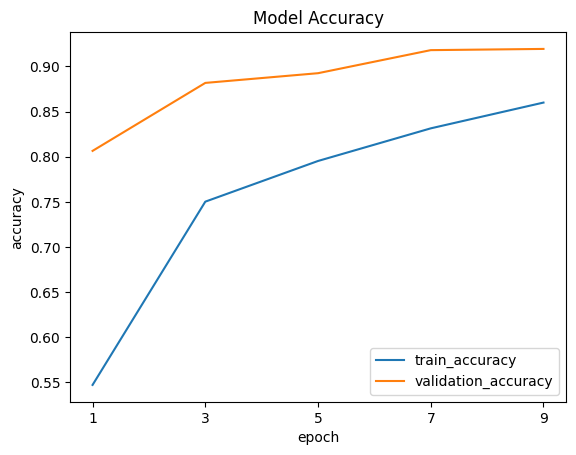

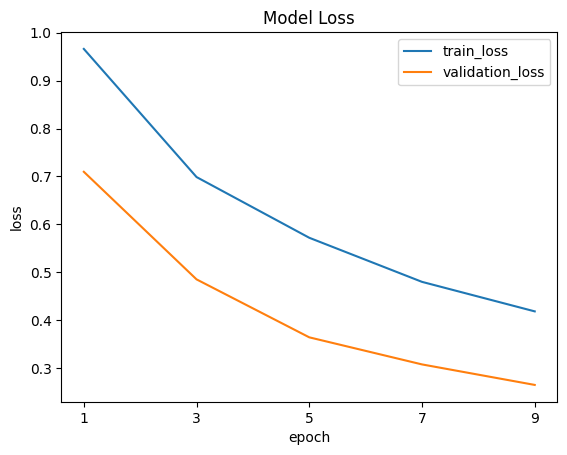

In [37]:
import matplotlib.pyplot as plt

def filter_history(history, interesting_epochs):
    filtered_history = {
        'accuracy': [],
        'val_accuracy': [],
        'loss': [],
        'val_loss': []
    }
    for i in interesting_epochs:
        filtered_history['accuracy'].append(history.history['accuracy'][i-1])
        filtered_history['val_accuracy'].append(history.history['val_accuracy'][i-1])
        filtered_history['loss'].append(history.history['loss'][i-1])
        filtered_history['val_loss'].append(history.history['val_loss'][i-1])
    return filtered_history

def plot_accuracy(history, title, interesting_epochs):
    filtered_history = filter_history(history, interesting_epochs)
    plt.title(title)
    plt.plot(filtered_history['accuracy'])
    plt.plot(filtered_history['val_accuracy'])
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train_accuracy', 'validation_accuracy'], loc='best')
    plt.xticks(ticks=range(len(interesting_epochs)), labels=interesting_epochs)
    plt.show()

def plot_loss(history, title, interesting_epochs):
    filtered_history = filter_history(history, interesting_epochs)
    plt.title(title)
    plt.plot(filtered_history['loss'])
    plt.plot(filtered_history['val_loss'])
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train_loss', 'validation_loss'], loc='best')
    plt.xticks(ticks=range(len(interesting_epochs)), labels=interesting_epochs)
    plt.show()

# Exemple d'utilisation
interesting_epochs = [1, 3, 5, 7, 9]

plot_accuracy(history, 'Model Accuracy', interesting_epochs)
plot_loss(history, 'Model Loss', interesting_epochs)


In [29]:
class PyDataset:
    def __init__(self, *args, **kwargs):
        # Assurez-vous d'appeler le constructeur de la classe parente
        super().__init__(**kwargs)
        # Initialisation de votre classe
        # ...

In [ ]:
#model training with 20 epochs

In [30]:
from tensorflow.keras.layers import Dropout, Dense, GlobalAveragePooling2D
from tensorflow.keras.regularizers import l2
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, Callback, CSVLogger
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow.keras.backend as K
import os

# Classe de rappel personnalisée pour enregistrer le modèle aux epochs spécifiés
class CustomModelCheckpoint(Callback):
    def __init__(self, save_epochs):
        super(CustomModelCheckpoint, self).__init__()
        self.save_epochs = save_epochs

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) in self.save_epochs:
            filepath = f'model_epoch_{epoch + 1:02d}.keras'
            self.model.save(filepath)
            print(f'\nModèle sauvegardé à: {filepath}')

# Paramètres et prétraitement des données
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=1e-6)

K.clear_session()
n_classes = 3
img_width, img_height = 299, 299
train_data_dir = 'train_mini'
validation_data_dir = 'test_mini'
nb_train_samples = 2250
nb_validation_samples = 750
batch_size = 8

train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1. / 255)

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

validation_generator = test_datagen.flow_from_directory(
    validation_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

# Création du modèle
inception = InceptionV3(weights='imagenet', include_top=False)
x = inception.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.2)(x)
predictions = Dense(n_classes, kernel_regularizer=l2(0.005), activation='softmax')(x)

model = Model(inputs=inception.input, outputs=predictions)
model.compile(optimizer=SGD(learning_rate=0.0001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])

# Définition des epochs à sauvegarder
save_epochs = [1, 3, 5, 7, 9,11,13,15,17,19]
custom_checkpoint = CustomModelCheckpoint(save_epochs)

# Chemin pour les logs
logs_dir = os.path.join(os.getcwd(), 'logs')
if not os.path.exists(logs_dir):
    os.makedirs(logs_dir)

csv_logger = CSVLogger(os.path.join(logs_dir, 'history_3class.log'))

# Entraînement du modèle
history = model.fit(train_generator,
                    steps_per_epoch=nb_train_samples // batch_size,
                    validation_data=validation_generator,
                    validation_steps=nb_validation_samples // batch_size,
                    epochs=20,
                    verbose=1,
                    callbacks=[csv_logger, custom_checkpoint, early_stopping, reduce_lr])

# Sauvegarde du modèle final
model.save('model_trained_3class.keras')


Found 2250 images belonging to 3 classes.
Found 750 images belonging to 3 classes.
Epoch 1/20
281/281 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.4468 - loss: 1.0752
Modèle sauvegardé à: model_epoch_01.keras
281/281 ━━━━━━━━━━━━━━━━━━━━ 879s 3s/step - accuracy: 0.4472 - loss: 1.0749 - val_accuracy: 0.8306 - val_loss: 0.6490 - learning_rate: 1.0000e-04
Epoch 2/20
  1/281 ━━━━━━━━━━━━━━━━━━━━ 12:31 3s/step - accuracy: 0.3750 - loss: 1.1349

C:\Users\Zaïneb\AppData\Local\Programs\Python\Python312\Lib\contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(value)


281/281 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.3750 - loss: 1.1349 - val_accuracy: 0.6667 - val_loss: 0.7578 - learning_rate: 1.0000e-04
Epoch 3/20
281/281 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7322 - loss: 0.7103
Modèle sauvegardé à: model_epoch_03.keras
281/281 ━━━━━━━━━━━━━━━━━━━━ 854s 3s/step - accuracy: 0.7323 - loss: 0.7101 - val_accuracy: 0.8952 - val_loss: 0.4352 - learning_rate: 1.0000e-04
Epoch 4/20
281/281 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.8750 - loss: 0.4060 - val_accuracy: 0.8333 - val_loss: 0.7886 - learning_rate: 1.0000e-04
Epoch 5/20
281/281 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7882 - loss: 0.6079
Modèle sauvegardé à: model_epoch_05.keras
281/281 ━━━━━━━━━━━━━━━━━━━━ 846s 3s/step - accuracy: 0.7882 - loss: 0.6078 - val_accuracy: 0.9126 - val_loss: 0.3303 - learning_rate: 1.0000e-04
Epoch 6/20
281/281 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 1.0000 - loss: 0.2297 - val_accuracy: 1.0000 - val_loss: 0.2307 - learning_rate: 1.0000e-

In [182]:
#!pip install pandas

In [158]:
import pandas as pd

# Supposez que vous avez l'objet history après l'entraînement
history_df = pd.DataFrame(history.history)

# Définissez le chemin du fichier de log
log_file_path = 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\history_3class.log'

# Enregistrez le DataFrame dans un fichier .log
history_df.to_csv(log_file_path, index=False)


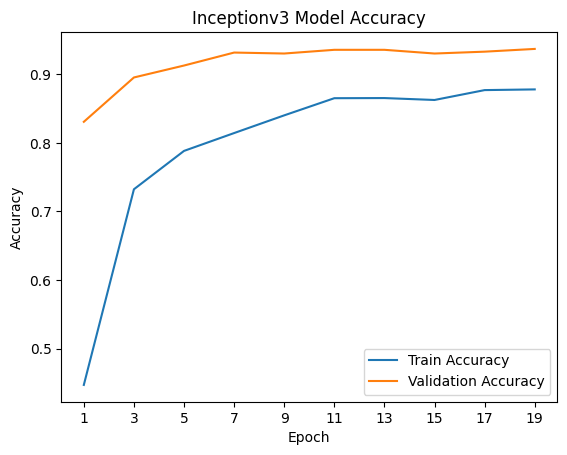

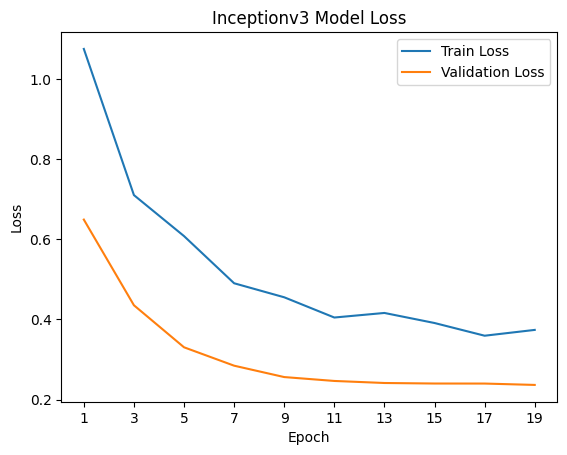

In [177]:
import pandas as pd
import matplotlib.pyplot as plt

# Définir le chemin du fichier de log
log_file_path = 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\history_3class.log'

# Lire le fichier de log
history_df = pd.read_csv(log_file_path)

# Afficher les premières lignes du DataFrame pour vérifier le contenu
#print(history_df.head())

# Fonction pour filtrer l'historique basé sur les époques intéressantes
def filter_history(history_df, interesting_epochs):
    filtered_history = {
        'accuracy': [],
        'val_accuracy': [],
        'loss': [],
        'val_loss': []
    }
    for i in interesting_epochs:
        filtered_history['accuracy'].append(history_df['accuracy'].iloc[i-1])
        filtered_history['val_accuracy'].append(history_df['val_accuracy'].iloc[i-1])
        filtered_history['loss'].append(history_df['loss'].iloc[i-1])
        filtered_history['val_loss'].append(history_df['val_loss'].iloc[i-1])
    return filtered_history

# Fonction pour tracer la courbe de précision
def plot_accuracy(history_df, title, interesting_epochs):
    filtered_history = filter_history(history_df, interesting_epochs)
    plt.title(title)
    plt.plot(filtered_history['accuracy'], label='Train Accuracy')
    plt.plot(filtered_history['val_accuracy'], label='Validation Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.xticks(ticks=range(len(interesting_epochs)), labels=interesting_epochs)
    plt.show()

# Fonction pour tracer la courbe de perte
def plot_loss(history_df, title, interesting_epochs):
    filtered_history = filter_history(history_df, interesting_epochs)
    plt.title(title)
    plt.plot(filtered_history['loss'], label='Train Loss')
    plt.plot(filtered_history['val_loss'], label='Validation Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.xticks(ticks=range(len(interesting_epochs)), labels=interesting_epochs)
    plt.show()

# Exemple d'utilisation
interesting_epochs = [1, 3, 5, 7, 9, 11, 13, 15, 17, 19]

plot_accuracy(history_df, 'Inceptionv3 Model Accuracy', interesting_epochs)
plot_loss(history_df, 'Inceptionv3 Model Loss', interesting_epochs)







In [215]:
class_map_3 = train_generator.class_indices
class_map_3

Found 2250 images belonging to 3 classes.


{'apple_pie': 0, 'omelette': 1, 'pizza': 2}

In [39]:
#Predicting classes for new images from internet using the best trained model

In [152]:
%%time
# Loading the best saved model to make predictions
K.clear_session()
model_best = load_model('model_trained_3class.keras',compile = False)

CPU times: total: 6.2 s
Wall time: 5.04 s


In [115]:
def predict_class(model, images, show = True):
  for img in images:
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)                    
    img = np.expand_dims(img, axis=0)         
    img /= 255.                                      

    pred = model.predict(img)
    index = np.argmax(pred)
    food_list.sort()
    pred_value = food_list[index]
    if show:
        plt.imshow(img[0])                           
        plt.axis('off')
        plt.title(pred_value)
        plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


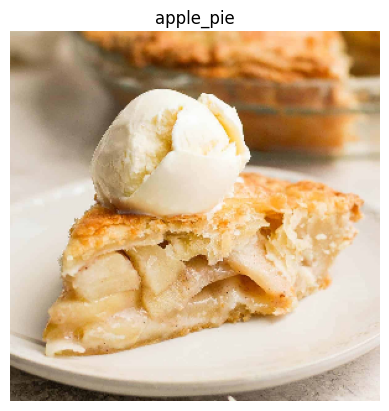

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


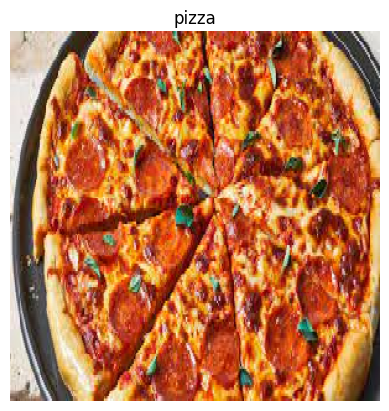

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


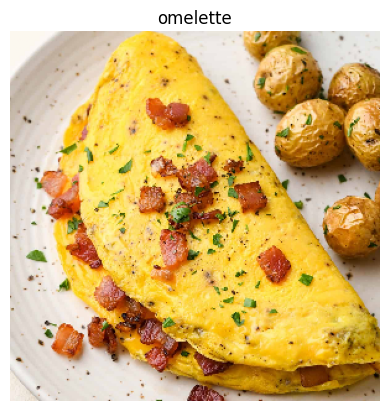

In [117]:
# Make a list of downloaded images and test the trained model
images = []
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\ApplePie.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Pizza.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Omelette.jpg')
predict_class(model_best, images, True)

In [120]:
from keras.models import load_model

# Assumez que votre modèle s'appelle model
model.save('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\model_trained_3class.keras')  # Sauvegarde du modèle au format h5


In [122]:
from tensorflow.keras.models import load_model

# Charger le modèle
model = load_model('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\model_trained_3class.keras')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


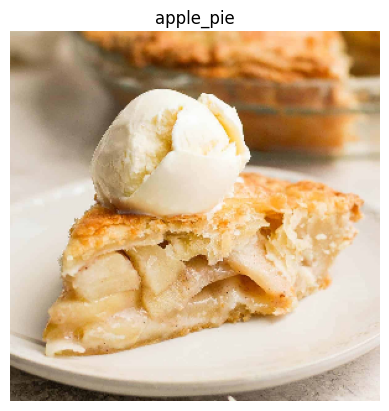

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


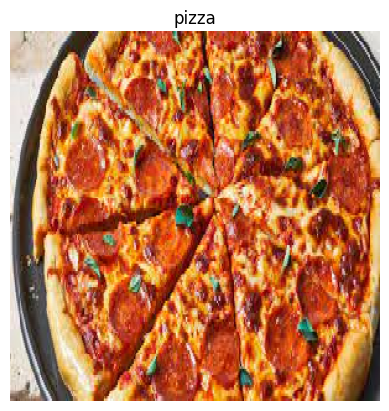

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


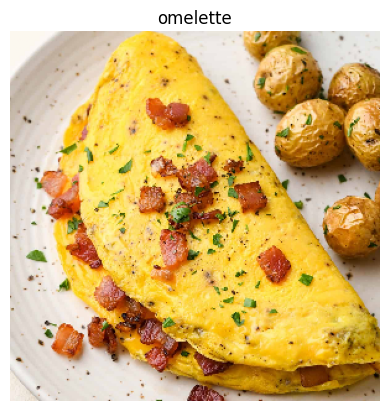

In [123]:
# Make a list of downloaded images and test the trained model
images = []
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\ApplePie.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Pizza.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Omelette.jpg')
predict_class(model_best, images, True)

In [ ]:
#we are going to train the model with 10 random classes 

In [31]:
# Helper function to select n random food classes
def pick_n_random_classes(n):
  food_list = []
  random_food_indices = random.sample(range(len(foods_sorted)),n) # We are picking n random food classes
  for i in random_food_indices:
    food_list.append(foods_sorted[i])
  food_list.sort()
  return food_list

In [34]:
# trying with more classes.lets randomly pick the food classes
n = 10
food_list = pick_n_random_classes(n)
food_list = ['apple_pie', 'beef_carpaccio', 'cup_cakes', 'foie_gras', 'french_fries', 'garlic_bread', 'pizza', 'spring_rolls', 'spaghetti_carbonara', 'strawberry_shortcake']
print("These are the randomly picked food classes we will be training the model on...\n", food_list)
src_train = 'train'
dest_train = 'train_mini'
src_test = 'test'
dest_test = 'test_mini'

These are the randomly picked food classes we will be training the model on...
 ['apple_pie', 'beef_carpaccio', 'cup_cakes', 'foie_gras', 'french_fries', 'garlic_bread', 'pizza', 'spring_rolls', 'spaghetti_carbonara', 'strawberry_shortcake']


In [35]:
# Create the new data subset of n classes
print("Creating training data folder with new classes...")
dataset_mini(food_list, src_train, dest_train)

Creating training data folder with new classes...
Copying images into apple_pie
Copying images into beef_carpaccio
Copying images into cup_cakes
Copying images into foie_gras
Copying images into french_fries
Copying images into garlic_bread
Copying images into pizza
Copying images into spring_rolls
Copying images into spaghetti_carbonara
Copying images into strawberry_shortcake


In [36]:
print("Creating test data folder with new classes")
dataset_mini(food_list, src_test, dest_test)

Creating test data folder with new classes
Copying images into apple_pie
Copying images into beef_carpaccio
Copying images into cup_cakes
Copying images into foie_gras
Copying images into french_fries
Copying images into garlic_bread
Copying images into pizza
Copying images into spring_rolls
Copying images into spaghetti_carbonara
Copying images into strawberry_shortcake


In [38]:
# Check how many files are in the test folder

import subprocess

# Define the PowerShell command
command = 'powershell.exe Get-ChildItem -Path .\\train_mini -File -Recurse | Measure-Object | %{$_.Count}'

# Run the command
result = subprocess.run(command, capture_output=True, text=True)

# Print the result
print("Total number of samples in test_mini folder")
print(result.stdout.strip())

Total number of samples in test_mini folder
7500


In [129]:
# Check how many files are in the test folder

import subprocess

# Define the PowerShell command
command = 'powershell.exe Get-ChildItem -Path .\\test_mini -File -Recurse | Measure-Object | %{$_.Count}'

# Run the command
result = subprocess.run(command, capture_output=True, text=True)

# Print the result
print("Total number of samples in test_mini folder")
print(result.stdout.strip())

Total number of samples in test_mini folder
2500


In [132]:
from tensorflow.keras.layers import Dropout, Dense, GlobalAveragePooling2D
from tensorflow.keras.regularizers import l2
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, Callback, CSVLogger
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow.keras.backend as K
import os

class CustomModelCheckpoint(Callback):
    def __init__(self, save_epochs):
        super(CustomModelCheckpoint, self).__init__()
        self.save_epochs = save_epochs

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) in self.save_epochs:
            filepath = f'model_epoch_{epoch + 1:02d}.keras'
            self.model.save(filepath)
            print(f'\nModèle sauvegardé à: {filepath}')

# Paramètres et prétraitement des données
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=1e-6)

K.clear_session()
n_classes = 10
img_width, img_height = 299, 299
train_data_dir = 'train_mini'
validation_data_dir = 'test_mini'
nb_train_samples = 7500
nb_validation_samples = 2500
batch_size = 16

train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1. / 255)

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

validation_generator = test_datagen.flow_from_directory(
    validation_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

# Création du modèle
inception = InceptionV3(weights='imagenet', include_top=False)
x = inception.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.2)(x)
predictions = Dense(n_classes, kernel_regularizer=l2(0.005), activation='softmax')(x)

model = Model(inputs=inception.input, outputs=predictions)
model.compile(optimizer=SGD(learning_rate=0.001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])

save_epochs = [1, 3, 5, 7, 9,11,13,15,17,19]
custom_checkpoint = CustomModelCheckpoint(save_epochs)

# Chemin pour les logs
logs_dir = os.path.join(os.getcwd(), 'logs')
if not os.path.exists(logs_dir):
    os.makedirs(logs_dir)

csv_logger = CSVLogger(os.path.join(logs_dir, 'history_10class.log'))

# Entraînement du modèle
history = model.fit(train_generator,
                    steps_per_epoch=nb_train_samples // batch_size,
                    validation_data=validation_generator,
                    validation_steps=nb_validation_samples // batch_size,
                    epochs=20,
                    verbose=1,
                    callbacks=[csv_logger, custom_checkpoint, early_stopping, reduce_lr])

# Sauvegarde du modèle final
model.save('model_trained_10class.keras')

Found 7500 images belonging to 10 classes.
Found 2500 images belonging to 10 classes.
Epoch 1/20
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.5682 - loss: 1.4304
Modèle sauvegardé à: model_epoch_01.keras
468/468 ━━━━━━━━━━━━━━━━━━━━ 2860s 6s/step - accuracy: 0.5685 - loss: 1.4295 - val_accuracy: 0.9038 - val_loss: 0.4148 - learning_rate: 0.0010
Epoch 2/20
468/468 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - accuracy: 0.7500 - loss: 0.6568 - val_accuracy: 0.7500 - val_loss: 0.3788 - learning_rate: 0.0010
Epoch 3/20
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.8646 - loss: 0.5166
Modèle sauvegardé à: model_epoch_03.keras
468/468 ━━━━━━━━━━━━━━━━━━━━ 3015s 6s/step - accuracy: 0.8646 - loss: 0.5166 - val_accuracy: 0.9159 - val_loss: 0.3521 - learning_rate: 0.0010
Epoch 4/20
468/468 ━━━━━━━━━━━━━━━━━━━━ 6s 963us/step - accuracy: 0.9375 - loss: 0.2960 - val_accuracy: 0.7500 - val_loss: 0.4071 - learning_rate: 0.0010
Epoch 5/20
468/468 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.907

In [41]:
%%time
# Loading the best saved model to make predictions
K.clear_session()
model_best = load_model('model_trained_10class.keras',compile = False)

CPU times: total: 2.23 s
Wall time: 1.93 s


In [43]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Supposons que vous ayez utilisé train_generator pour l'entraînement
train_generator = ImageDataGenerator().flow_from_directory(
    'train_mini',  # Chemin vers votre répertoire de données d'entraînement
    target_size=(150, 150),  # Taille des images
    batch_size=32,
    class_mode='categorical'  # ou 'binary' selon votre cas
)

# Obtenir le dictionnaire des classes
class_indices = train_generator.class_indices
print(class_indices)

# Inverser le dictionnaire pour obtenir les noms de classes à partir des indices
class_names = {v: k for k, v in class_indices.items()}
print(class_names)


Found 7500 images belonging to 10 classes.
{'apple_pie': 0, 'beef_carpaccio': 1, 'cup_cakes': 2, 'foie_gras': 3, 'french_fries': 4, 'garlic_bread': 5, 'pizza': 6, 'spaghetti_carbonara': 7, 'spring_rolls': 8, 'strawberry_shortcake': 9}
{0: 'apple_pie', 1: 'beef_carpaccio', 2: 'cup_cakes', 3: 'foie_gras', 4: 'french_fries', 5: 'garlic_bread', 6: 'pizza', 7: 'spaghetti_carbonara', 8: 'spring_rolls', 9: 'strawberry_shortcake'}


In [52]:
#Save class dictionary
import json
import os
save_path = os.path.join('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model', 'class_indices.json')

# Enregistrer le dictionnaire dans un fichier JSON
with open(save_path, 'w') as json_file:
    json.dump(class_indices, json_file)

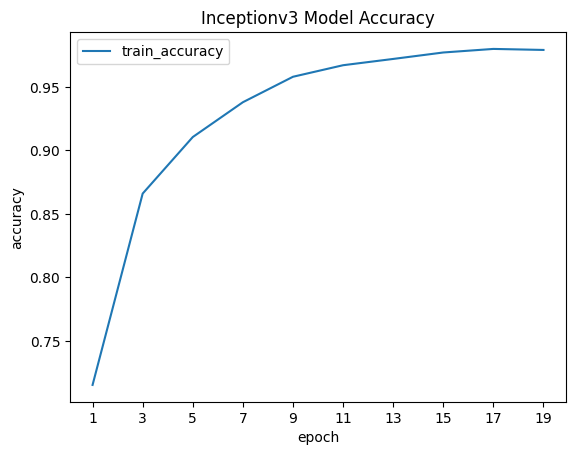

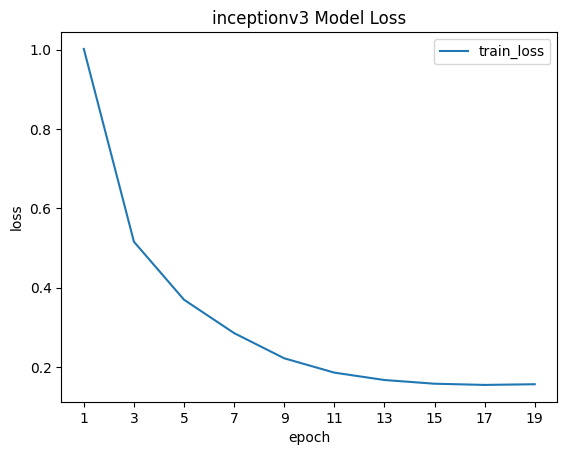

In [136]:
import matplotlib.pyplot as plt

def filter_history(history, interesting_epochs):
    filtered_history = {
        'accuracy': [],
        'val_accuracy': [],
        'loss': [],
        'val_loss': []
    }
    for i in interesting_epochs:
        filtered_history['accuracy'].append(history.history['accuracy'][i-1])
        filtered_history['val_accuracy'].append(history.history['val_accuracy'][i-1])
        filtered_history['loss'].append(history.history['loss'][i-1])
        filtered_history['val_loss'].append(history.history['val_loss'][i-1])
    return filtered_history

def plot_accuracy(history, title, interesting_epochs):
    filtered_history = filter_history(history, interesting_epochs)
    plt.title(title)
    plt.plot(filtered_history['accuracy'])
    #plt.plot(filtered_history['val_accuracy'])
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train_accuracy'], loc='best')
    plt.xticks(ticks=range(len(interesting_epochs)), labels=interesting_epochs)
    plt.show()

def plot_loss(history, title, interesting_epochs):
    filtered_history = filter_history(history, interesting_epochs)
    plt.title(title)
    plt.plot(filtered_history['loss'])
    #plt.plot(filtered_history['val_loss'])
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train_loss'], loc='best')
    plt.xticks(ticks=range(len(interesting_epochs)), labels=interesting_epochs)
    plt.show()
    # Exemple d'utilisation
interesting_epochs = [1,3, 5,7, 9,11,13,15,17,19]

plot_accuracy(history, 'Inceptionv3 Model Accuracy', interesting_epochs)
plot_loss(history, 'inceptionv3 Model Loss', interesting_epochs)


In [39]:
%%time
# Loading the best saved model to make predictions
K.clear_session()
model_best = load_model('model_trained_10class.keras',compile = False)


CPU times: total: 2.25 s
Wall time: 2.66 s


In [138]:
def predict_class(model, images, show = True):
  for img in images:
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)                    
    img = np.expand_dims(img, axis=0)         
    img /= 255.                                      

    pred = model.predict(img)
    index = np.argmax(pred)
    food_list.sort()
    pred_value = food_list[index]
    if show:
        plt.imshow(img[0])                           
        plt.axis('off')
        plt.title(pred_value)
        plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


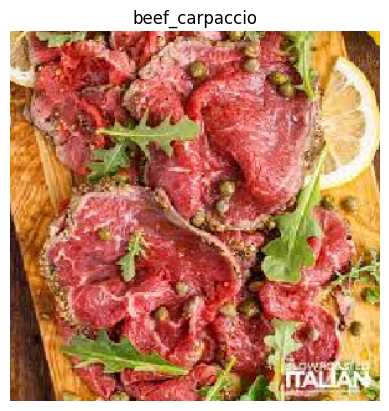

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


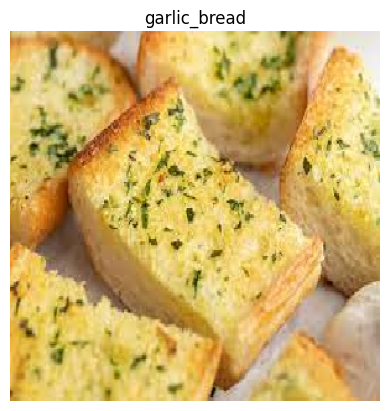

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


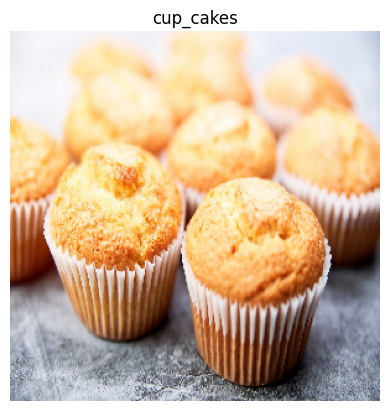

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


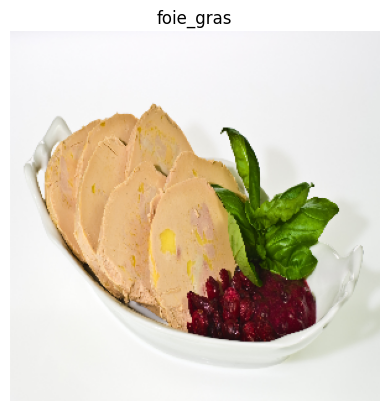

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


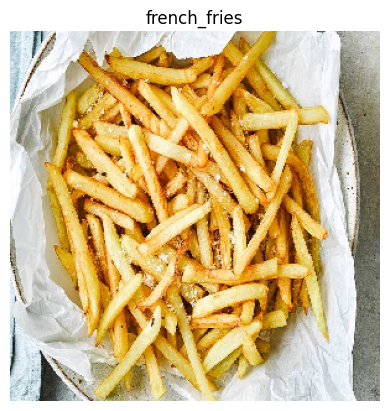

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


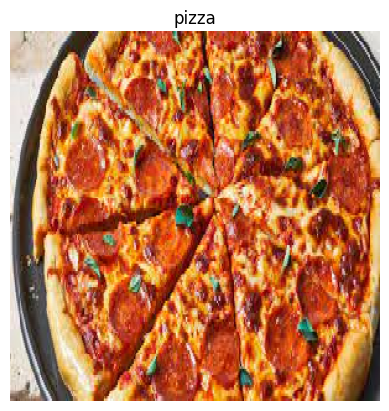

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


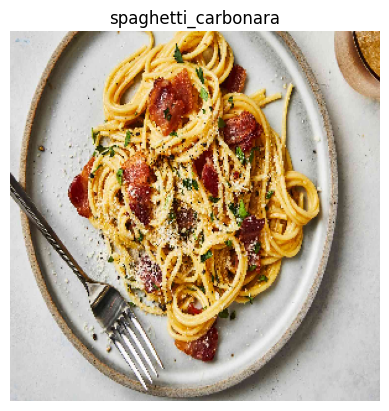

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


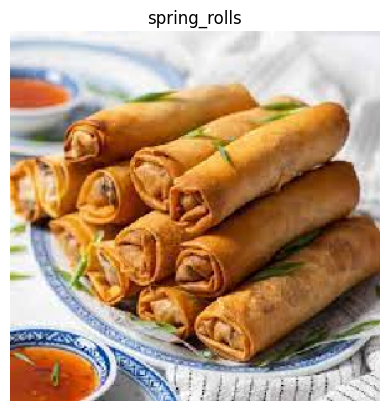

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


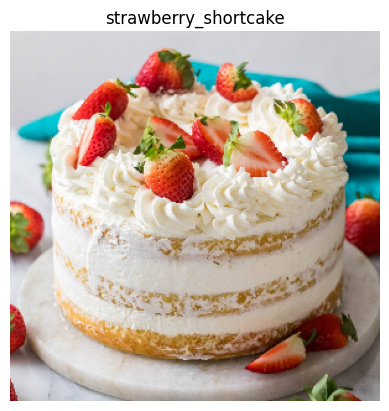

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


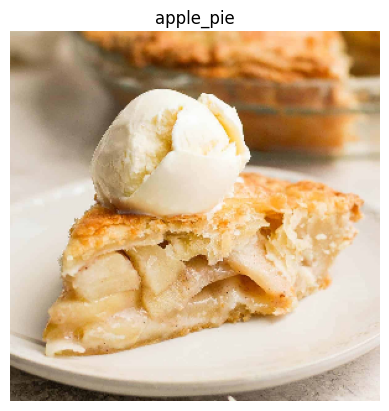

In [139]:
# Make a list of downloaded images and test the trained model
images = []
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Beef.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\bread.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\cake.jpeg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\foie.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\fries.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Pizza.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Spaghetti.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\SpringRolls.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\StrawberryShortCake.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\ApplePie.jpg')
predict_class(model_best, images, True)

In [140]:
from keras.models import load_model

# Assumez que votre modèle s'appelle model
model.save('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\model_trained_10class.keras')  # Sauvegarde du modèle au format h5

In [141]:
from tensorflow.keras.models import load_model

# Charger le modèle
model = load_model('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\model_trained_10class.keras')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


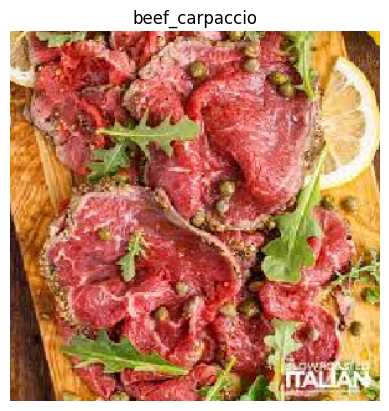

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


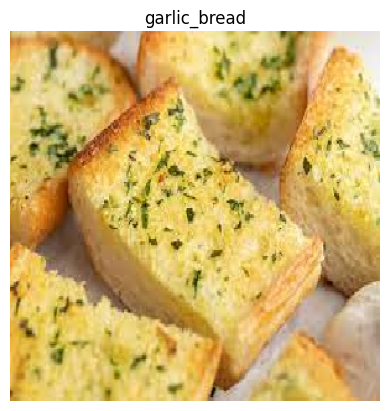

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


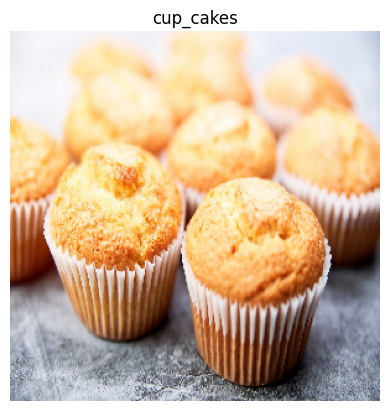

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


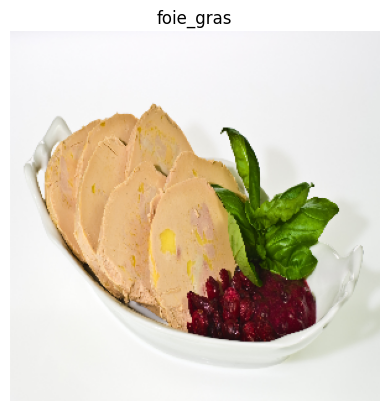

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


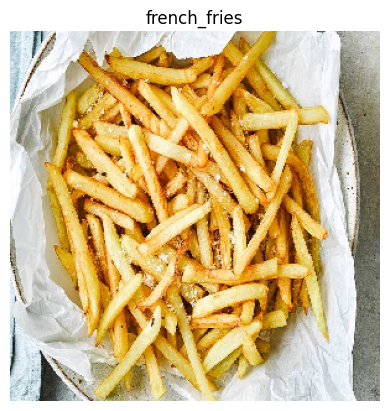

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


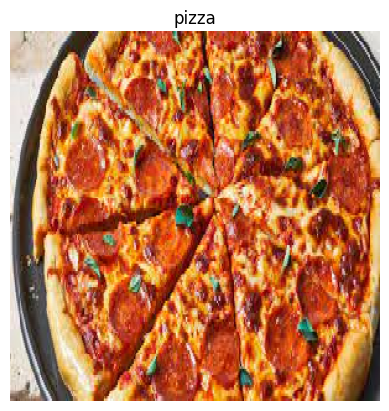

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


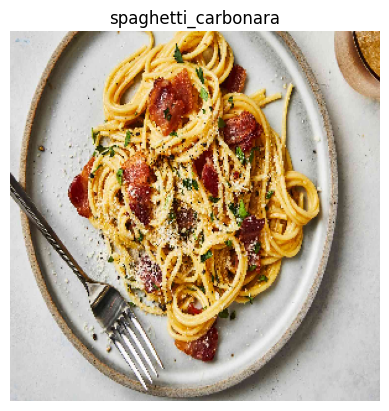

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


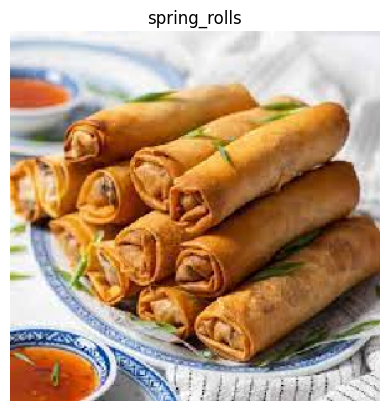

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


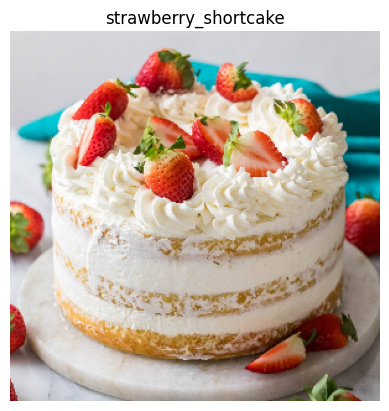

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


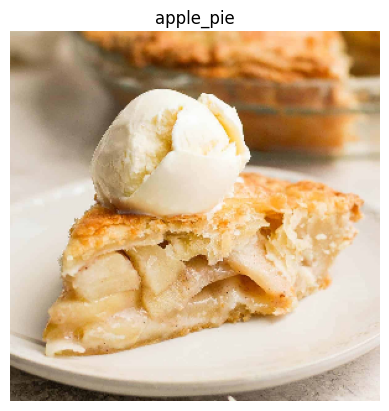

In [142]:
# Make a list of downloaded images and test the trained model
images = []
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Beef.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\bread.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\cake.jpeg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\foie.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\fries.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Pizza.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Spaghetti.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\SpringRolls.jfif')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\StrawberryShortCake.jpg')
images.append('C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\ApplePie.jpg')
predict_class(model_best, images, True)

In [178]:
import pandas as pd

# Supposez que vous avez l'objet history après l'entraînement
history_df = pd.DataFrame(history.history)

# Définissez le chemin du fichier de log
log_file_path = 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\history_10class.log'

# Enregistrez le DataFrame dans un fichier .log
history_df.to_csv(log_file_path, index=False)

In [184]:
from tensorflow.keras.models import load_model

# Charger le modèle
model = load_model('C:\\Users\\Zaïneb\\Desktop\\food_cal\\model\\model_trained_3class.keras')

In [185]:
model.summary()#gives us the list of all the layers in the network along with other useful details

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                  ┃ Output Shape              ┃         Param # ┃ Connected to               ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)      │ (None, None, None, 3)     │               0 │ -                          │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv2d (Conv2D)               │ (None, None, None, 32)    │             864 │ input_layer[0][0]          │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ batch_normalization           │ (None, None, None, 32)    │              96 │ conv2d[0][0]               │
│ (BatchNormalization)          │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ activation (Activation)       │ (None, None, None, 32)    │               0 │ batch_normalization[0][0]  │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv2d_1 (Conv2D)             │ (None, None, None, 32)    │           9,216 │ activation[0][0]           │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ batch_normalization_1         │ (None, None, None, 32)    │              96 │ conv2d_1[0][0]             │
│ (BatchNormalization)          │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ activation_1 (Activation)     │ (None, None, None, 32)    │               0 │ batch_normalization_1[0][… │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv2d_2 (Conv2D)             │ (None, None, None, 64)    │          18,432 │ activation_1[0][0]         │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ batch_normalization_2         │ (None, None, None, 64)    │             192 │ conv2d_2[0][0]             │
│ (BatchNormalization)          │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ activation_2 (Activation)     │ (None, None, None, 64)    │               0 │ batch_normalization_2[0][… │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ max_pooling2d (MaxPooling2D)  │ (None, None, None, 64)    │               0 │ activation_2[0][0]         │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv2d_3 (Conv2D)             │ (None, None, None, 80)    │           5,120 │ max_pooling2d[0][0]        │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ batch_normalization_3         │ (None, None, None, 80)    │             240 │ conv2d_3[0][0]             │
│ (BatchNormalization)          │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ activation_3 (Activation)     │ (None, None, None, 80)    │               0 │ batch_normalization_3[0][… │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv2d_4 (Conv2D)             │ (None, None, None, 192)   │         138,240 │ activation_3[0][0]         │
├───────────────────────────────┼───────────────────────────┼───────────────

 Total params: 44,096,456 (168.21 MB)

 Trainable params: 22,031,011 (84.04 MB)

 Non-trainable params: 34,432 (134.50 KB)

 Optimizer params: 22,031,013 (84.04 MB)

In [186]:
#Take a numpy array (a tensor) and transform it in such a way that it becomes viewable as an RGB image.
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [187]:
#a layer is a stage in a neural network that processes data:Input Layer,
#Hidden Layers(Convolutional Layer,Pooling Layer,Activation Layer,Dropout Layer,Dense (Fully Connected) Layer)),output layer
#a filter is a tool used in convolutional layers to detect specific features in the input data.
#function used to visualize the pattern that a specific filter in a given layer of a neural network is looking for. 
#It generates an image that maximizes the activation of a specified filter.
def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = K.function([model.input], [loss, grads])
    
    # We start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

In [188]:
#function designed to preprocess an image, display it, and then obtain the activations (output values) from a given model for that image
def get_activations(img, model_activations):
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)                    
    img = np.expand_dims(img, axis=0)         
    img /= 255. 
    plt.imshow(img[0])
    plt.show()
    return model_activations.predict(img)
    

In [189]:
#function designed to visualize the activations (feature maps) from different layers of a neural network
def show_activations(activations, layer_names):
    
    images_per_row = 16

    # Now let's display our feature maps
    for layer_name, layer_activation in zip(layer_names, activations):
        # This is the number of features in the feature map
        n_features = layer_activation.shape[-1]

        # The feature map has shape (1, size, size, n_features)
        size = layer_activation.shape[1]

        # We will tile the activation channels in this matrix
        n_cols = n_features // images_per_row
        display_grid = np.zeros((size * n_cols, images_per_row * size))

        # We'll tile each filter into this big horizontal grid
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0,
                                                 :, :,
                                                 col * images_per_row + row]
                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size,
                             row * size : (row + 1) * size] = channel_image

        # Display the grid
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

    plt.show()

In [190]:
len(model.layers)#Check how many layers are in the trained model(this includes the 1st input layer as well)

315

In [191]:
#visualizing the outputs of all the layers

In [192]:
# We start with index 1 instead of 0, as input layer is at index 0
layers = [layer.output for layer in model.layers[1:11]]
# We now initialize a model which takes an input and outputs the above chosen layers
activations_output = models.Model(inputs=model.input, outputs=layers)

In [193]:
layers #the 10 chosen layers contain 3 convolution, 3 batch normalization, 3 activation and 1 max pooling layers

[<KerasTensor shape=(None, None, None, 32), dtype=float32, sparse=False, name=keras_tensor_664>,
 <KerasTensor shape=(None, None, None, 32), dtype=float32, sparse=False, name=keras_tensor_666>,
 <KerasTensor shape=(None, None, None, 32), dtype=float32, sparse=False, name=keras_tensor_668>,
 <KerasTensor shape=(None, None, None, 32), dtype=float32, sparse=False, name=keras_tensor_670>,
 <KerasTensor shape=(None, None, None, 32), dtype=float32, sparse=False, name=keras_tensor_672>,
 <KerasTensor shape=(None, None, None, 32), dtype=float32, sparse=False, name=keras_tensor_674>,
 <KerasTensor shape=(None, None, None, 64), dtype=float32, sparse=False, name=keras_tensor_676>,
 <KerasTensor shape=(None, None, None, 64), dtype=float32, sparse=False, name=keras_tensor_678>,
 <KerasTensor shape=(None, None, None, 64), dtype=float32, sparse=False, name=keras_tensor_680>,
 <KerasTensor shape=(None, None, None, 64), dtype=float32, sparse=False, name=keras_tensor_682>]

In [194]:
layer_names = []
for layer in model.layers[1:11]:
    layer_names.append(layer.name)
print(layer_names)#names of selected layers

['conv2d', 'batch_normalization', 'activation', 'conv2d_1', 'batch_normalization_1', 'activation_1', 'conv2d_2', 'batch_normalization_2', 'activation_2', 'max_pooling2d']


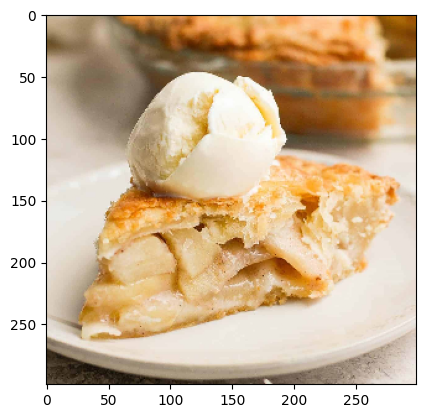

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


In [196]:
#Provide an input to the model and get the activations of all the 10 chosen layers
food = 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\ApplePie.jpg'
activations = get_activations(food,activations_output)


C:\Users\Zaïneb\AppData\Local\Temp\ipykernel_12508\3404407802.py:25: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
C:\Users\Zaïneb\AppData\Local\Temp\ipykernel_12508\3404407802.py:28: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


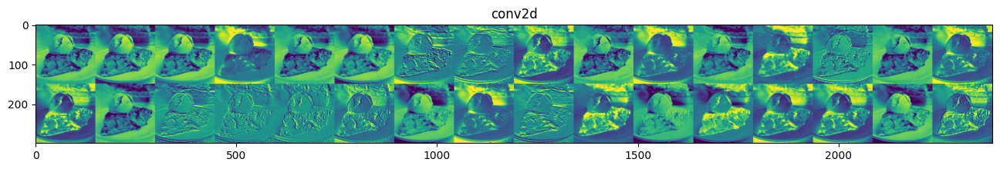

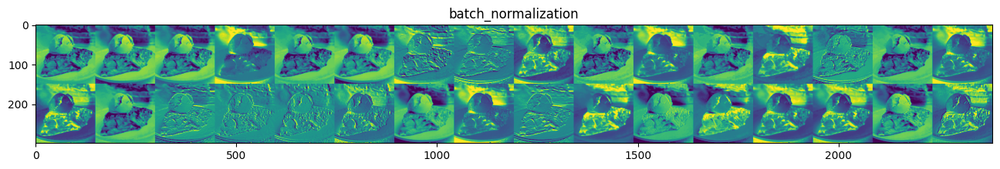

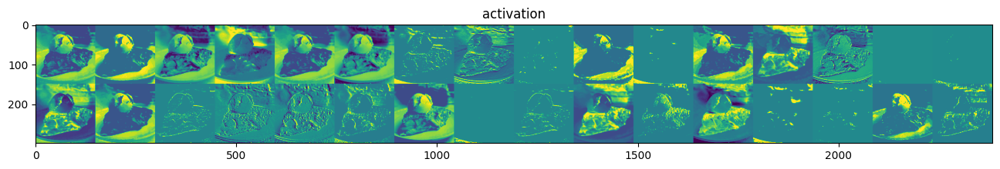

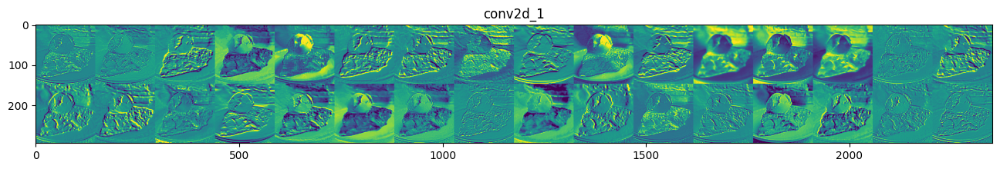

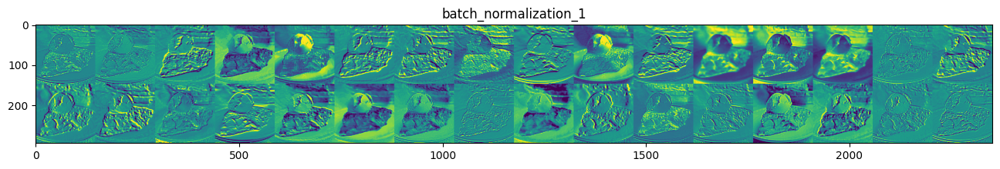

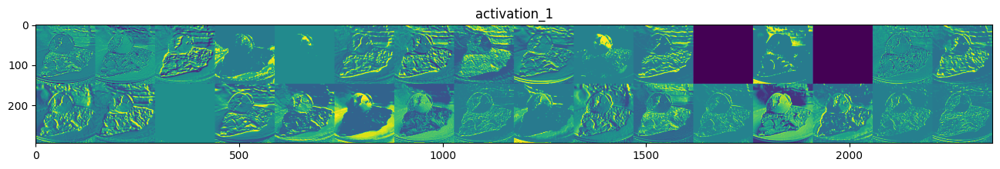

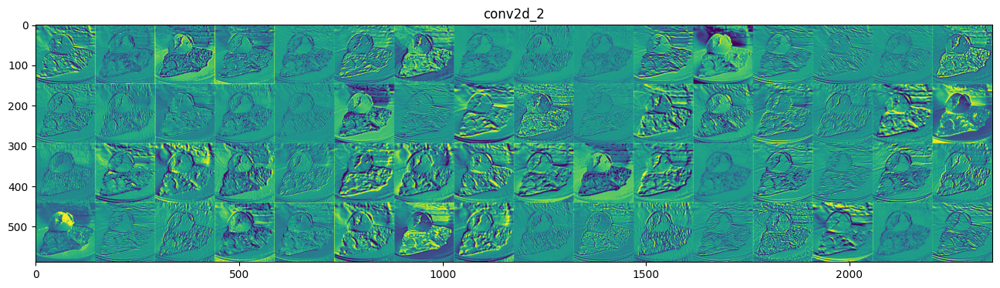

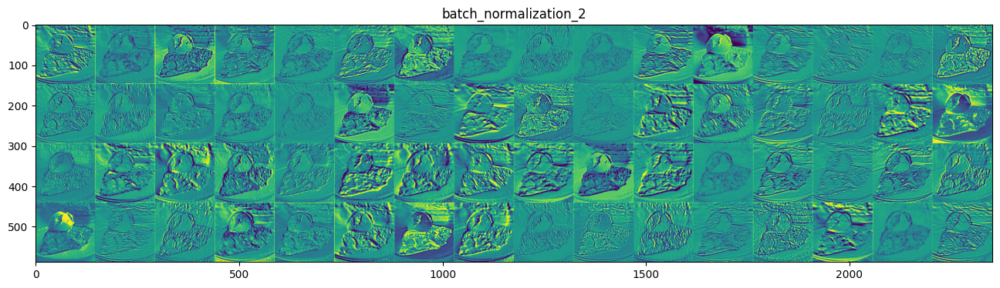

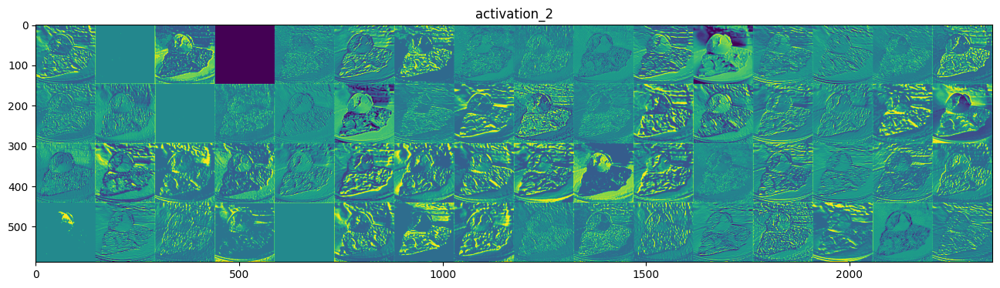

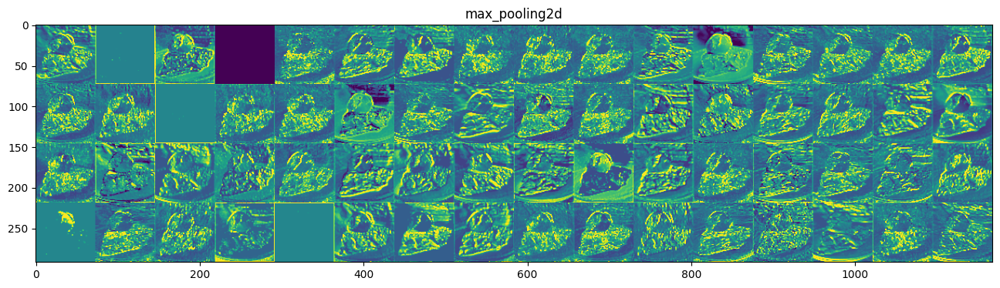

In [197]:
#Visualize the activations of intermediate layers from layer 1 to 10
show_activations(activations, layer_names)

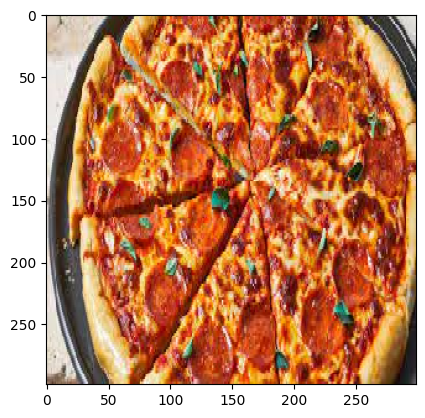

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


In [199]:
food = 'C:\\Users\\Zaïneb\\Desktop\\food_cal\\server\\test_images\\Pizza.jfif'
activations = get_activations(food,activations_output)

C:\Users\Zaïneb\AppData\Local\Temp\ipykernel_12508\3404407802.py:25: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
C:\Users\Zaïneb\AppData\Local\Temp\ipykernel_12508\3404407802.py:28: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


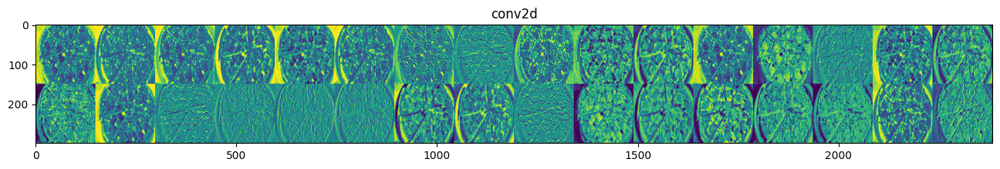

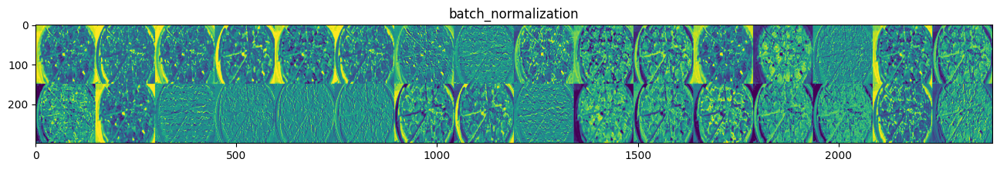

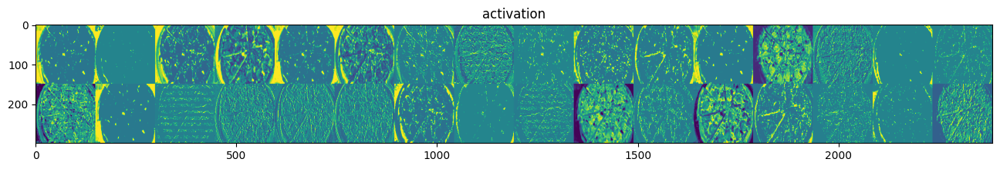

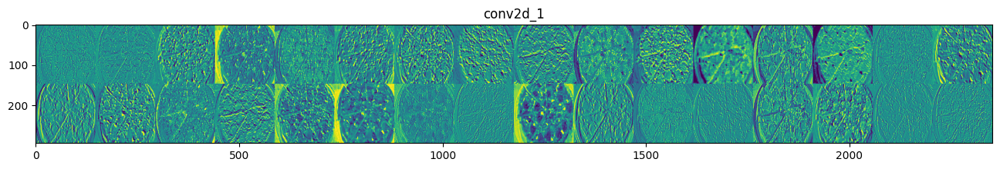

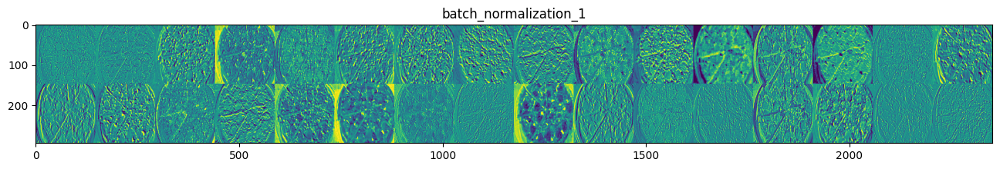

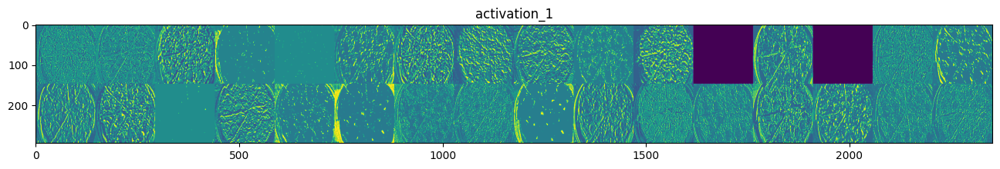

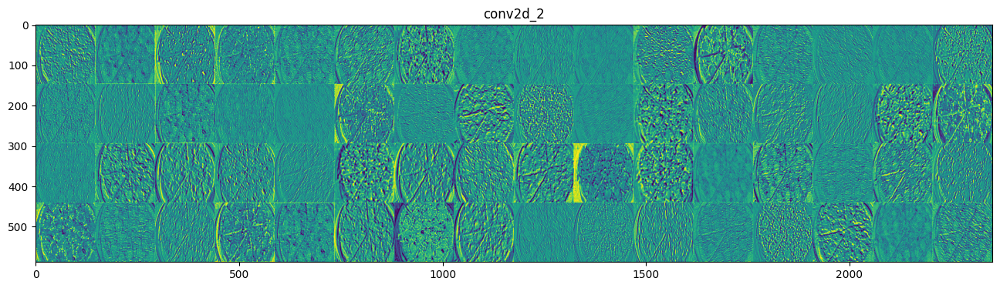

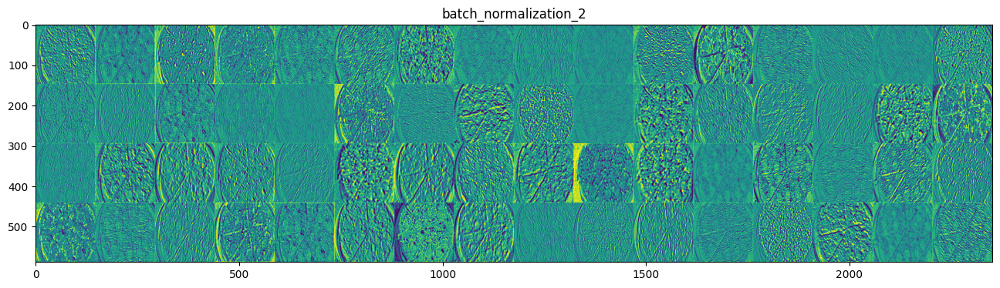

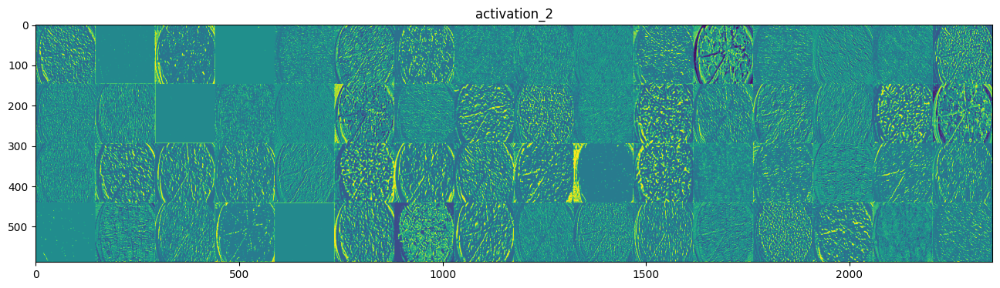

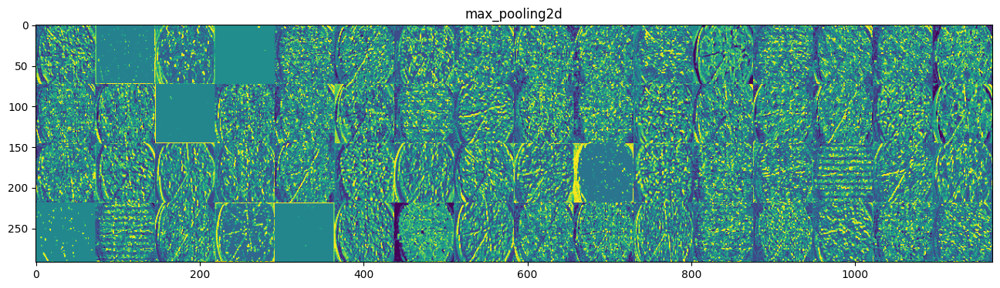

In [200]:
show_activations(activations, layer_names)

In [201]:
# Get the index of activation_1 layer which has sparse activations
ind = layer_names.index('activation_1')
sparse_activation = activations[ind]
a = sparse_activation[0, :, :, 13]
a

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)

In [202]:
all (np.isnan(a[j][k])  for j in range(a.shape[0]) for k in range(a.shape[1]))

True

In [203]:
# Get the index of batch_normalization_1 layer which has sparse activations
ind = layer_names.index('batch_normalization_1')
sparse_activation = activations[ind]
b = sparse_activation[0, :, :, 13]
b

array([[-20.101501 , -23.71373  , -23.71373  , ..., -70.672745 ,
        -77.8972   , -70.672745 ],
       [-16.489273 , -20.101501 , -20.101501 , ..., -67.06052  ,
        -70.672745 , -74.28497  ],
       [-12.877029 , -16.489273 ,  -9.264801 , ..., -48.99936  ,
        -77.8972   , -70.672745 ],
       ...,
       [-23.71373  , -23.71373  , -38.16266  , ...,  19.633049 ,
         19.633049 ,  16.02082  ],
       [  1.5718918,   5.18412  ,  23.245277 , ...,  16.02082  ,
         12.408585 ,   8.796356 ],
       [  8.796356 ,  41.306442 ,  81.040985 , ...,  16.02082  ,
         12.408585 ,   5.18412  ]], dtype=float32)

In [204]:
#all the values of the activation map of the batch_normalization layer  are negative .
#This activation in batch_normalization_1 is passed to the next layer activation_1 as input.
#activation_1 is an activation layer and ReLu is the activation function used.
#ReLu takes an input value, returns 0 if its negative, the value otherwise
#Since the input to activation array contains all negative values, the activation layer fills its activation map with all zeros for the index
#Now we know why we have those 2 sparse activations in activation_1 layer

Text(0.5, 1.0, 'Conv2d_3')

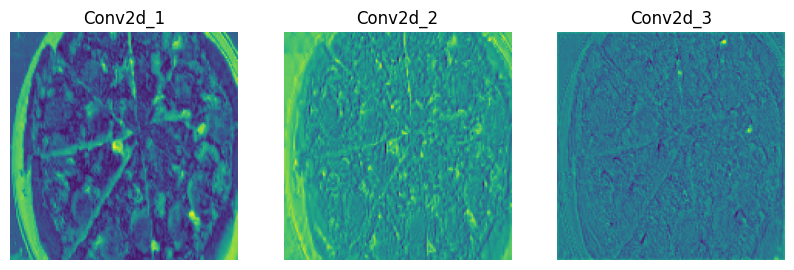

In [205]:
#Show the activation outputs of 1st, 2nd and 3rd Conv2D layer activations to compare how layers get abstract with depth
first_convlayer_activation = activations[0]
second_convlayer_activation = activations[3]
third_convlayer_activation = activations[6]
f,ax = plt.subplots(1,3, figsize=(10,10))
ax[0].imshow(first_convlayer_activation[0, :, :, 3], cmap='viridis')
ax[0].axis('OFF')
ax[0].set_title('Conv2d_1')
ax[1].imshow(second_convlayer_activation[0, :, :, 3], cmap='viridis')
ax[1].axis('OFF')
ax[1].set_title('Conv2d_2')
ax[2].imshow(third_convlayer_activation[0, :, :, 3], cmap='viridis')
ax[2].axis('OFF')
ax[2].set_title('Conv2d_3')

In [206]:
#To validate how model attributes the features to class output, we can generate heat maps using gradients to find out which regions in the 
#input images were instrumental in determining the class

In [216]:
print("Showing the class map..")
print(class_map_3)

Showing the class map..
{'apple_pie': 0, 'omelette': 1, 'pizza': 2}
